In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle

import pathlib 
import os
import pickle
import torch

import PT_files.save_load as sl
from PT_files.new_afterburner_torch import torch_burner
from PT_files.model import DnCNN_B
from DnCNN_NP.layers_np import relu, np_BatchNorm2d, np_Conv2d
from DnCNN_NP.model_np import np_DnCNN
from DnCNN_NP.np_afterburner import numpy_burner

import time 
import pdb

Using cuda device


**NOTEBOOK FOR VISUALIZING THE RESULTS OF THE UPDATED NUMPY AND PYTORCH AFTERBURNERS.**

These constitue an updated version of the `img_full_pass` function that was in the original versions of the two denoising algorithms. This version has larger patch sizes and padding on the FVC image. This rids the model of artifacts cropping up in the denoised image.

Load weights, data, numpy im2col index matrices, numpy layer lists (used in the for loop construction of the model), and create a single input sample for testing

In [2]:
# Loading data & weights dictionary

# Create path to model parameters
PATH = pathlib.Path(os.getenv('PSCRATCH'))
DATA = PATH / 'DESI_dn' /'Model_params'
assert DATA.exists()

# Load the trained model parameters
name = '2k_model_bs64_e800_ps50_Adam.pth'
weights = torch.load(str(DATA / name))


#Load the actual data that we're working on & print the shape of this data
test_data = sl.NERSC_load('test_data_40%_6000.npy')
sample = test_data[0]
print('Shape of test set=', sample.shape)

# Create single sample to replicate what the input will look like when working
# the FVC pipeline
samp_6k = sample[0]
samp_6k = np.reshape(samp_6k, (1, 1, 6000, 6000))

# Load the saved im2col matrices of indices & im2col layer lists
# im2col_mat = sl.NERSC_load(name='im2col_layer_dict_2k.pkl')
# im2col_mat = sl.NERSC_load(name='im2col_layer_dict_2k_halved.pkl')

# im2col_mat = sl.NERSC_load(name='im2col_2k_indices.pkl')
# im2col_layer_list = sl.NERSC_load(name='2k_NP_layers_list.pkl')

Shape of test set= (108, 1, 6000, 6000)


Change `afterburner` to run on single example (ie. for use on FVC image per day) as well as get rid of the `print` output it gives when ran

# Code to create and save full image passes for numpy and pytorch, as well as, afterburner via pytorch

In [3]:
# # PyTorch afterburner function
# # torch_afterburner = afterburner(dataset=test_data, model=DnCNN_B,  model_params='2k_model_bs64_e800_ps50_Adam.pth', samp_idx=0) 
# torch_denoised_2k = torch_burner(data=test_data[0][0][0],
#                            model=DnCNN_B,
#                            model_params='2k_model_bs64_e800_ps50_Adam.pth')

# # Numpy afterburner function (not using overlapping inference patches)
# np_denoised_2k = np_afterburner(data=samp_6k, 
#                             model=np_DnCNN,
#                             weights_dict=weights, 
#                             layer_list=im2col_layer_list,
#                             im2col_mat=im2col_mat)
# # Saving the data from the pytorch afterburner, pytorch full pass (no overlaps),
# # and numpy full pass (no overlaps)

# sl.NERSC_save(name='torch_afterburner_2k', data=torch_afterburner)
# sl.NERSC_save(name='torch_fullpass_2k', data=torch_denoised_2k)
# sl.NERSC_save(name='numpy_fullpass_2k', data=np_denoised_2k)

In [4]:
# plt.imshow(np_denoised_2k[0][0][5500:5700, 3900:4100])

In [5]:
# plt.imshow(torch_denoised_2k[0][0][5500:5700, 3900:4100])

In [6]:
# sl.NERSC_save(name='numpy_afterburner', data=np_denoised_2k)
# sl.NERSC_save(name='torch_afterburner', data=torch_denoised_2k)

# Code to load the saved full image passes (pytorch/numpy) and afterburner (pytorch)

In [7]:
# Load in the data from the pytorch afterburner, pytorch full pass (no overlaps),
# and numpy full pass (no overlaps). The commented code above creates the data,
# as well as, saves the data to disk
# torch_afterburner = sl.NERSC_load(name='torch_afterburner_2k.npy')
saved_torch = sl.NERSC_load(name='torch_afterburner.npy')
saved_numpy = sl.NERSC_load(name='numpy_afterburner.npy')

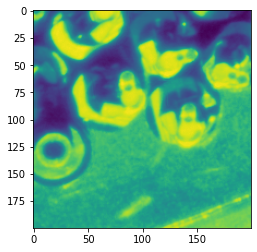

In [8]:
plt.imshow(saved_torch[0][0][5500:5700, 3900:4100])

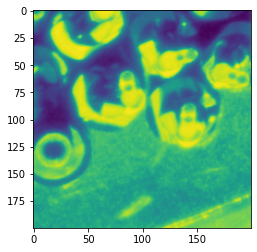

In [9]:
plt.imshow(saved_numpy[0][0][5500:5700, 3900:4100])

In [10]:
# Checking to see that the denoising results between PyTorch and Numpy match to
# some tolerance (They do not match at default tolerance settings)
print('Torch full pass vs. numpy full pass =', np.allclose(saved_torch, saved_numpy)) # False

Torch full pass vs. numpy full pass = False


# Most important results plots

Residual plots

In [11]:
def residual_comparison(raw_data, torch_full, np_full, x_start, y_start, size):
    """
    Creates 3x3 grid of 3 different pairings between the 3 different
    denoising approaches. (ie. full image passes with no overlapping
    regions implemented in PyTorch and NumPy, as well as, PyTorch
    implementation of the afterburner function, which has multiple 
    overlapping regions to account for artifacts that could crop up
    when tiling inference patches).
    
    These pairs are:
        1. PyTorch full pass vs. Numpy full pass
        2. PyTorch Afterburner vs. Numpy full pass
        3. PyTorch Afterburner vs. PyTorch full pass
    """
    
    torch_resid = raw_data[1][0][0][y_start:y_start+size, x_start:x_start+size] - torch_full[0][0][y_start:y_start+size, x_start:x_start+size]
    numpy_resid = raw_data[1][0][0][y_start:y_start+size, x_start:x_start+size] - np_full[0][0][y_start:y_start+size, x_start:x_start+size]
    torch_numpy_resid = torch_full[0][0][y_start:y_start+size, x_start:x_start+size] - np_full[0][0][y_start:y_start+size, x_start:x_start+size]

    fig, ax = plt.subplots(1, 4, figsize=(30, 26))
    
    # For non-residual FVC images
    vmin, vmax = np.percentile(raw_data[0][0][0], (1,99))
    # For residuals
    vmax_resid = np.percentile(np.abs((raw_data[1][0][0] - raw_data[0][0][0])), (70))
    vmin_resid = -vmax_resid

    # Comparing Truth  vs. Noisy residual
    ax[0].imshow(raw_data[1][0][0][y_start:y_start+size, x_start:x_start+size] - raw_data[0][0][0][y_start:y_start+size, x_start:x_start+size],
                 cmap='bwr', vmin=vmin_resid, vmax=vmax_resid, origin='upper', interpolation='none')
    ax[0].axis('off')
    ax[0].set_title('Truth - Noise',fontsize=28) 
    ax[1].imshow(torch_resid, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[1].axis('off')
    ax[1].set_title('Truth - Torch Denoised', fontsize=28)
    ax[2].imshow(numpy_resid, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[2].axis('off')
    ax[2].set_title('Truth - Numpy Denoised', fontsize=28)
    ax[3].imshow(torch_numpy_resid, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[3].axis('off')
    ax[3].set_title('Torch - Numpy Denoised', fontsize=28)
   
    
    fig.tight_layout()
    plt.show()
        
def focalplane_comparison(raw_data, torch_full, np_full, x_start, y_start, size):
    """
    Creates 3x3 grid of 3 different pairings between the 3 different
    denoising approaches. (ie. full image passes with no overlapping
    regions implemented in PyTorch and NumPy, as well as, PyTorch
    implementation of the afterburner function, which has multiple 
    overlapping regions to account for artifacts that could crop up
    when tiling inference patches).
    
    These pairs are:
        1. PyTorch full pass vs. Numpy full pass
        2. PyTorch Afterburner vs. Numpy full pass
        3. PyTorch Afterburner vs. PyTorch full pass
    """
    
    torch_resid = raw_data[1][0][0][y_start:y_start+size, x_start:x_start+size] - torch_full[0][0][y_start:y_start+size, x_start:x_start+size]
    numpy_resid = raw_data[1][0][0][y_start:y_start+size, x_start:x_start+size] - np_full[0][0][y_start:y_start+size, x_start:x_start+size]


    fig, ax = plt.subplots(1, 3, figsize=(30, 26))
    
    # For non-residual FVC images
    vmin, vmax = np.percentile(raw_data[0][0][0], (1,99))

    # Comparing Truth  vs. Noisy residual
    ax[0].imshow(raw_data[1][0][0][y_start:y_start+size, x_start:x_start+size], vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0].axis('off')
    ax[0].set_title('Truth',fontsize=28) 
    ax[1].imshow(torch_full[0][0][y_start:y_start+size, x_start:x_start+size], vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1].axis('off')
    ax[1].set_title('Torch Denoised', fontsize=28)
    ax[2].imshow(np_full[0][0][y_start:y_start+size, x_start:x_start+size], vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[2].axis('off')
    ax[2].set_title('Numpy Denoised', fontsize=28)
    
   
    
    fig.tight_layout()
    plt.show()

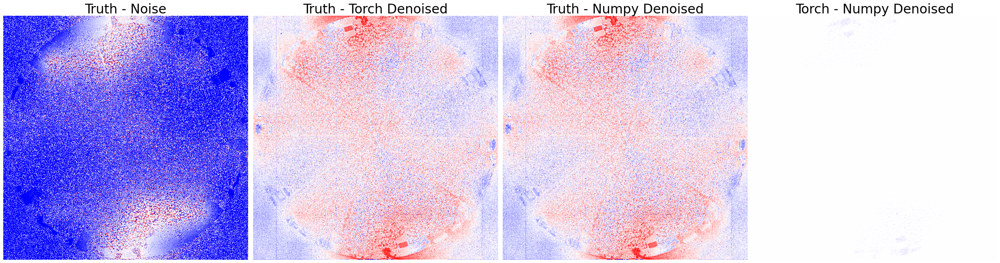

In [12]:
residual_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=0,
                      y_start=0,
                      size=6000)

In [13]:
# residual_comparison(raw_data=test_data,
#                       torch_full=saved_torch,
#                       np_full=saved_numpy,
#                       x_start=1500,
#                       y_start=2500,
#                       size=1000)

In [14]:
# residual_comparison(raw_data=test_data,
#                       torch_full=saved_torch,
#                       np_full=saved_numpy,
#                       x_start=1900,
#                       y_start=3000,
#                       size=200)

In [15]:
# focalplane_comparison(raw_data=test_data,
#                       torch_full=saved_torch,
#                       np_full=saved_numpy,
#                       x_start=1900,
#                       y_start=3000,
#                       size=200)

In [16]:
def residual_comparison(raw_data, torch_full, np_full, x_start, y_start, size):
    """
    Creates 3x3 grid of 3 different pairings between the 3 different
    denoising approaches. (ie. full image passes with no overlapping
    regions implemented in PyTorch and NumPy, as well as, PyTorch
    implementation of the afterburner function, which has multiple 
    overlapping regions to account for artifacts that could crop up
    when tiling inference patches).
    
    These pairs are:
        1. PyTorch full pass vs. Numpy full pass
        2. PyTorch Afterburner vs. Numpy full pass
        3. PyTorch Afterburner vs. PyTorch full pass
    """
    
    torch_resid = raw_data[1][0][0][y_start:y_start+size, x_start:x_start+size] - torch_full[0][0][y_start:y_start+size, x_start:x_start+size]
    numpy_resid = raw_data[1][0][0][y_start:y_start+size, x_start:x_start+size] - np_full[0][0][y_start:y_start+size, x_start:x_start+size]
    torch_numpy_resid = torch_full[0][0][y_start:y_start+size, x_start:x_start+size] - np_full[0][0][y_start:y_start+size, x_start:x_start+size]

    fig, ax = plt.subplots(1, 3, figsize=(30, 26))
    
    # For non-residual FVC images
    vmin, vmax = np.percentile(raw_data[0][0][0], (1,99))
    # For residuals
    vmax_resid = np.percentile(np.abs((raw_data[1][0][0] - raw_data[0][0][0])), (70))
    vmin_resid = -vmax_resid

    # Comparing Truth  vs. Noisy residual
    ax[0].imshow(raw_data[1][0][0][y_start:y_start+size, x_start:x_start+size] - raw_data[0][0][0][y_start:y_start+size, x_start:x_start+size],
                 cmap='bwr', vmin=vmin_resid, vmax=vmax_resid, origin='upper', interpolation='none')
    ax[0].axis('off')
    ax[0].set_title('Truth - Noise',fontsize=28) 
    ax[1].imshow(torch_resid, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[1].axis('off')
    ax[1].set_title('Truth - Torch Denoised', fontsize=28)
    ax[2].imshow(numpy_resid, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[2].axis('off')
    ax[2].set_title('Truth - Numpy Denoised', fontsize=28)
#     ax[3].imshow(torch_numpy_resid, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
#     ax[3].axis('off')
#     ax[3].set_title('Torch - Numpy Denoised', fontsize=28)
   
    
    fig.tight_layout()
    plt.show()

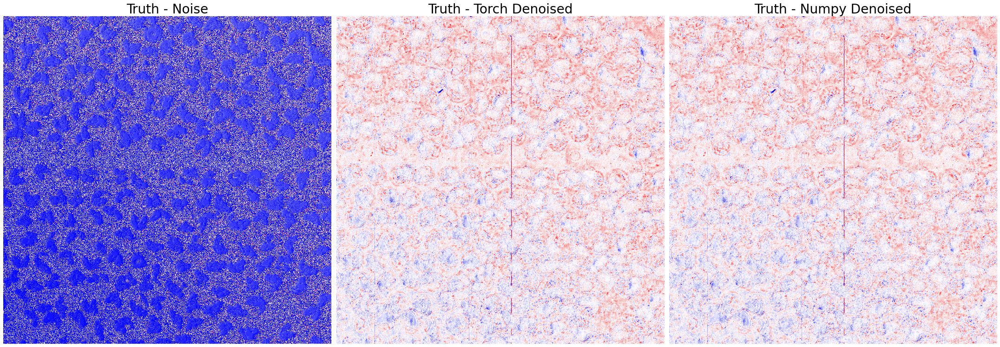

In [17]:
residual_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=1500,
                      y_start=2500,
                      size=1000)

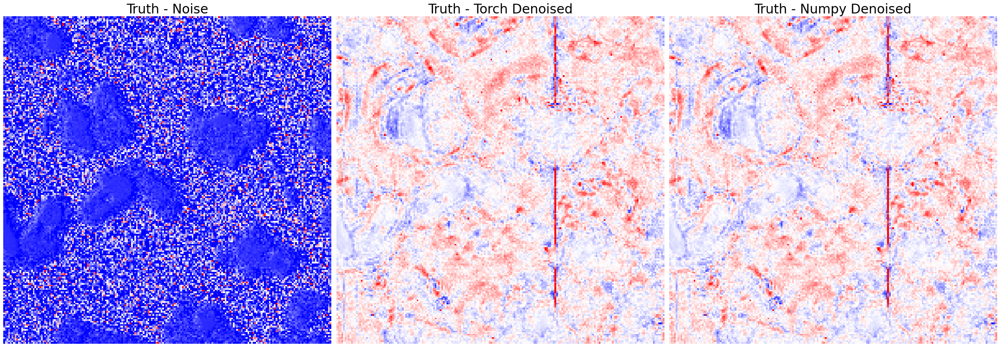

In [18]:
residual_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=1900,
                      y_start=3000,
                      size=200)

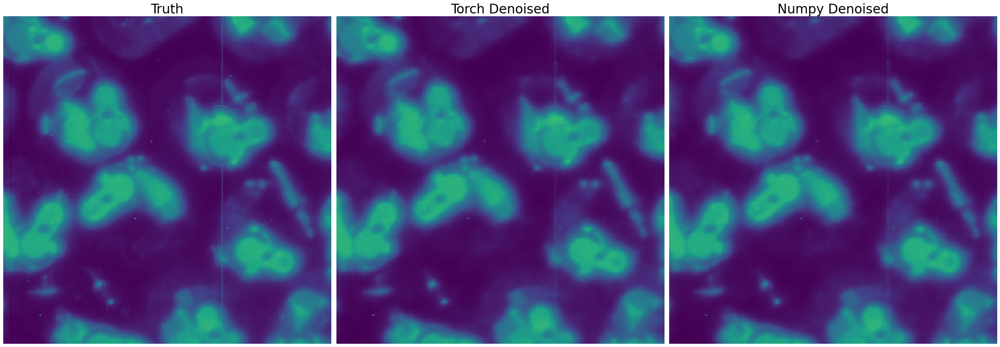

In [19]:
focalplane_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=1900,
                      y_start=3000,
                      size=200)

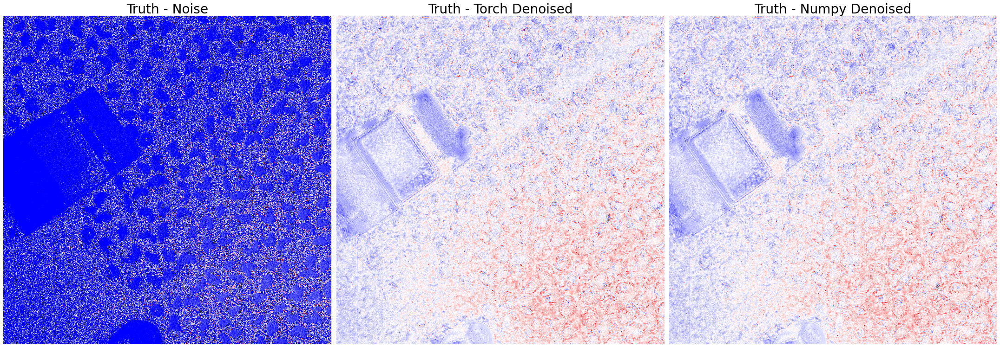

In [20]:
residual_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=500,
                      y_start=4000,
                      size=1000)

# focalplane_comparison(raw_data=test_data,
#                       torch_full=saved_torch,
#                       np_full=saved_numpy,
#                       x_start=500,
#                       y_start=4000,
#                       size=1000)

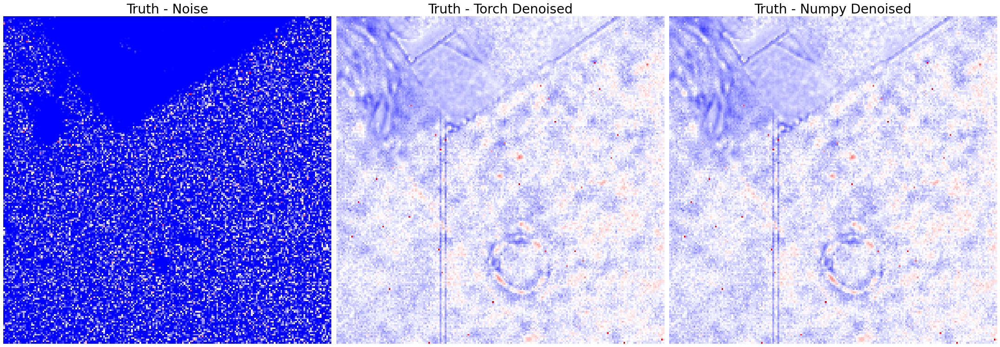

In [21]:
residual_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=500,
                      y_start=4600,
                      size=200)

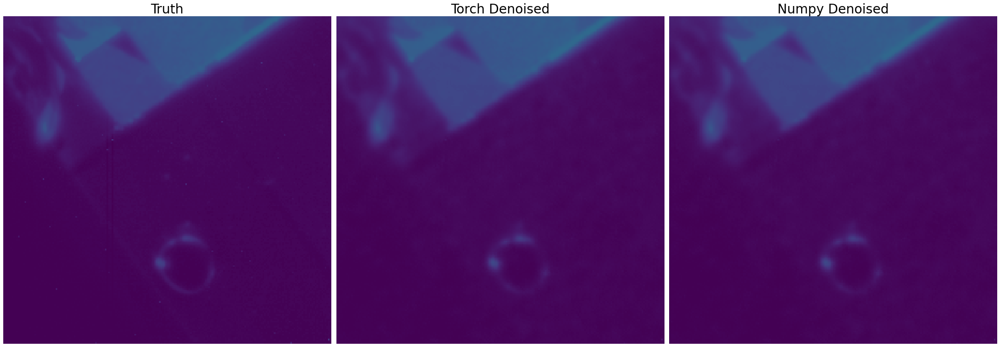

In [22]:
focalplane_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=500,
                      y_start=4600,
                      size=200)

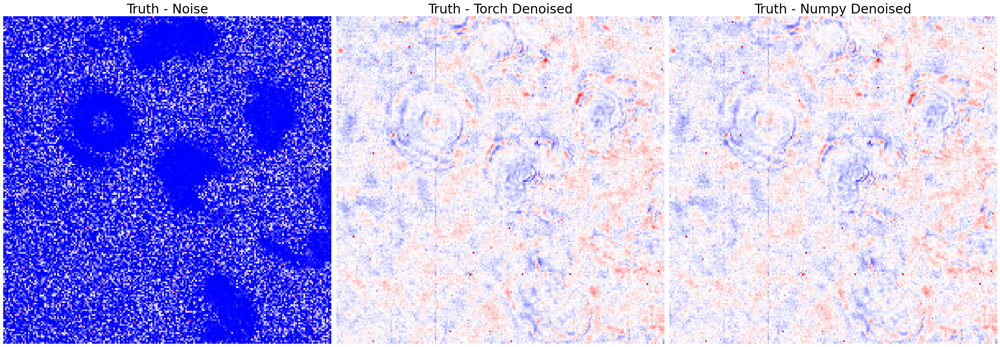

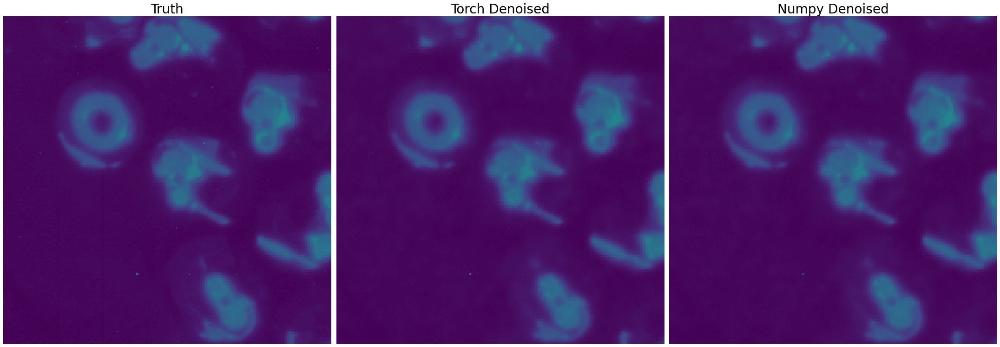

In [23]:

residual_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=700,
                      y_start=4600,
                      size=200)

focalplane_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=700,
                      y_start=4600,
                      size=200)

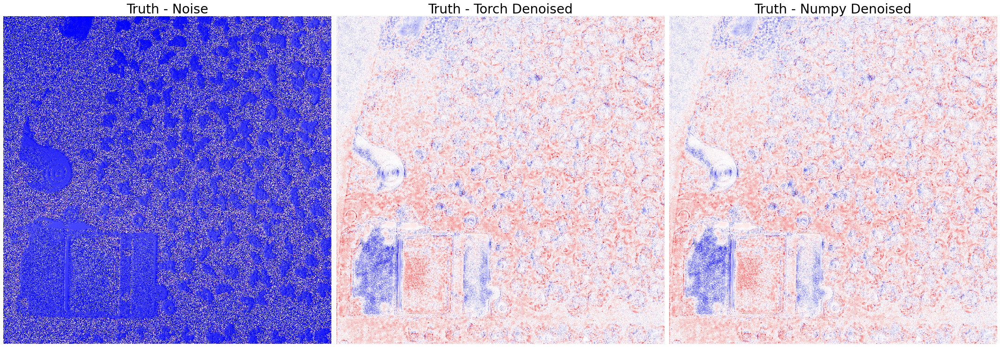

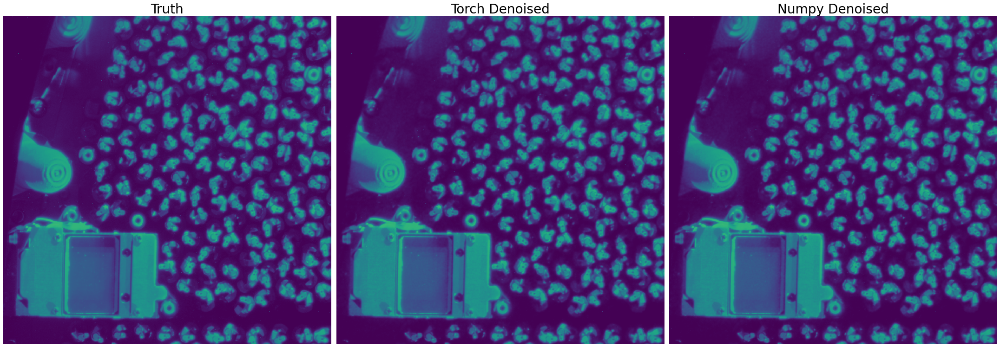

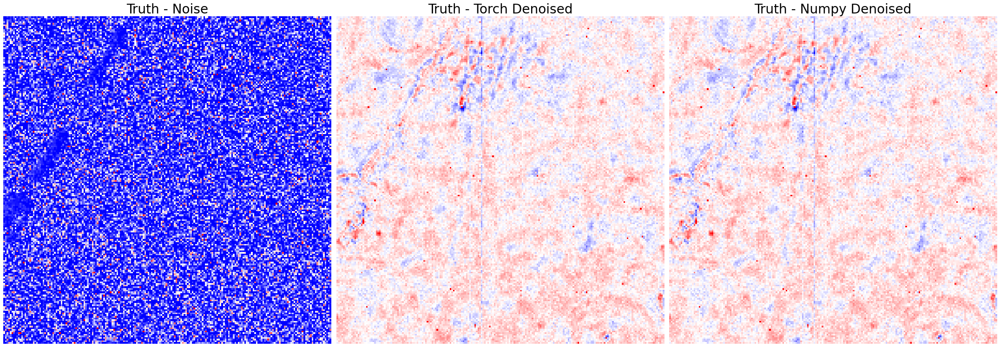

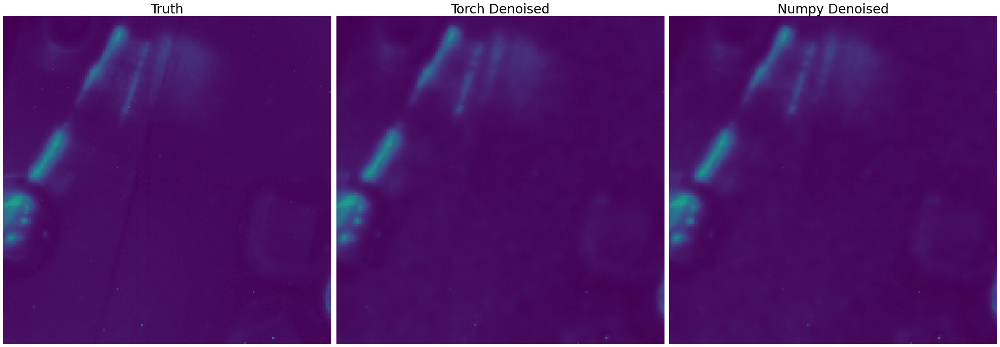

In [24]:
residual_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=0,
                      y_start=2000,
                      size=1000)

focalplane_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=0,
                      y_start=2000,
                      size=1000)


residual_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=100,
                      y_start=2150,
                      size=200)

focalplane_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=100,
                      y_start=2150,
                      size=200)

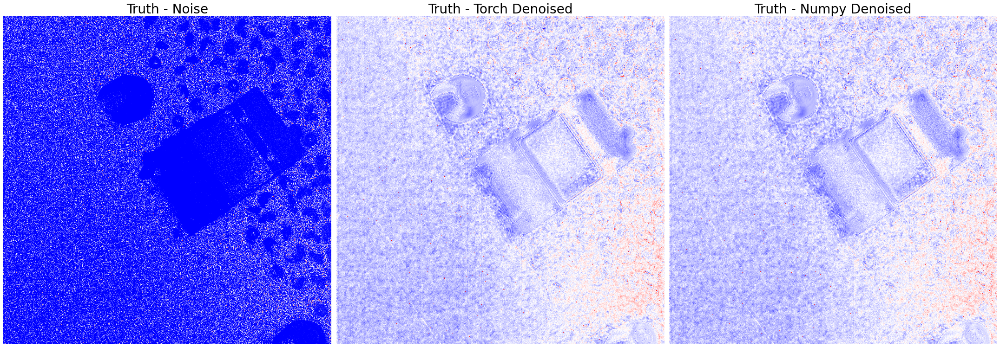

In [25]:
residual_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=0,
                      y_start=4000,
                      size=1000)

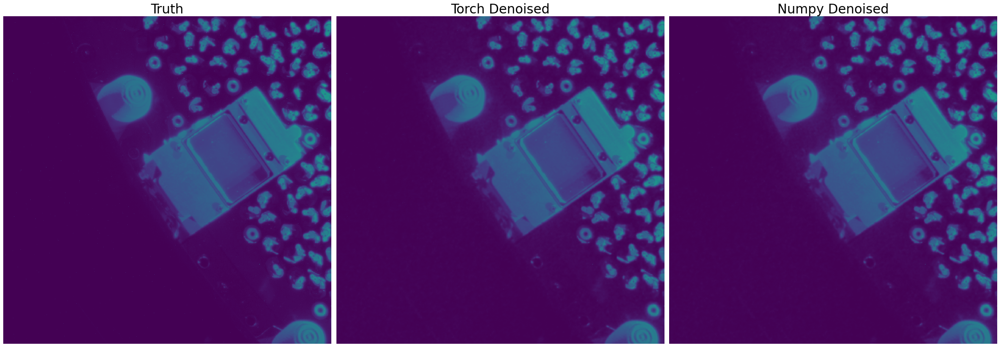

In [26]:
focalplane_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=0,
                      y_start=4000,
                      size=1000)   

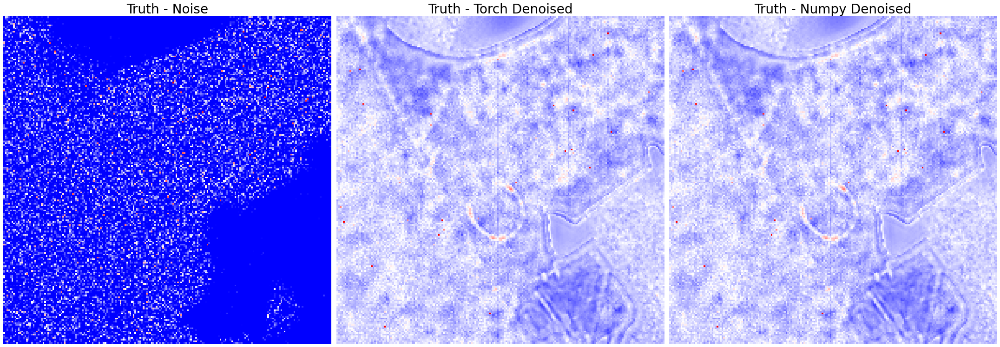

In [27]:
residual_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=300,
                      y_start=4300,
                      size=200)

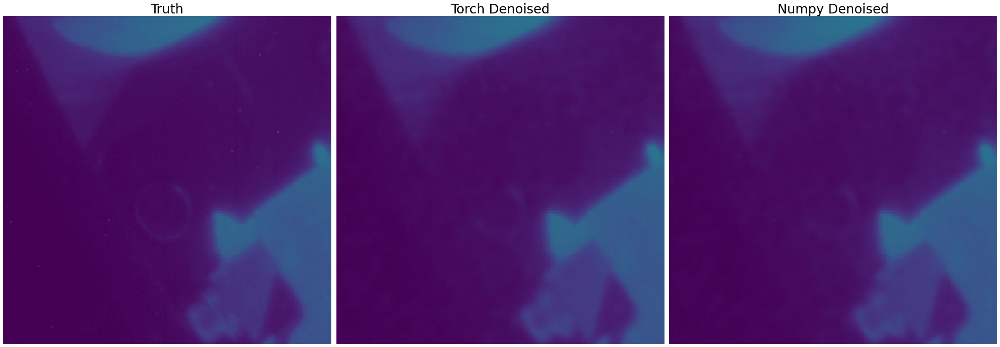

In [28]:
focalplane_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=300,
                      y_start=4300,
                      size=200)

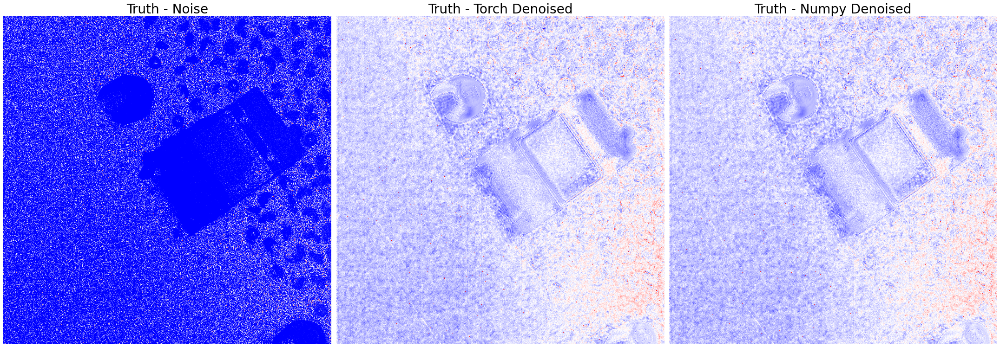

In [29]:
residual_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=0,
                      y_start=4000,
                      size=1000)

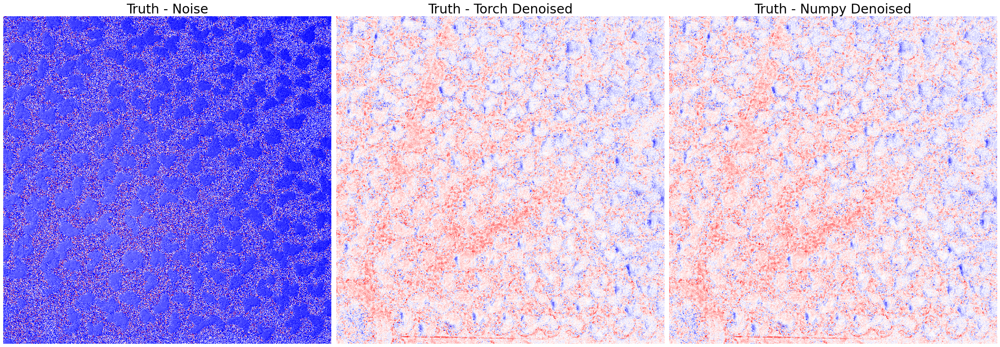

In [30]:
residual_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=3000,
                      y_start=2000,
                      size=1000)

## Normal color plots of the regions with weird lines that we found in the residuals

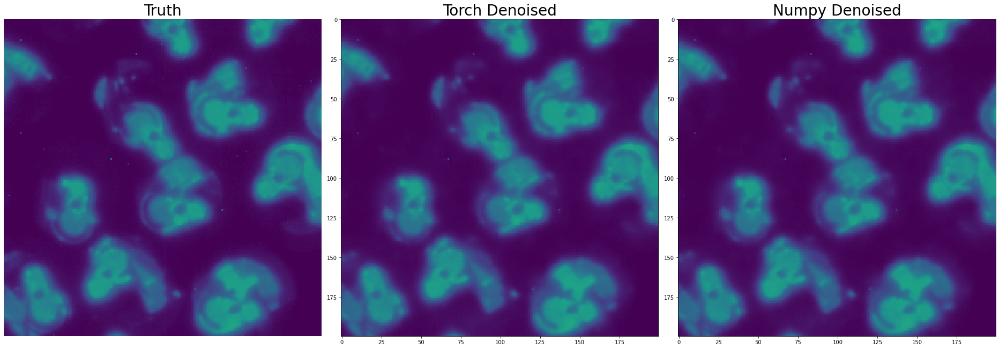

In [31]:
def focalplane_comparison(raw_data, torch_full, np_full, x_start, y_start, size):
    """
    Creates 3x3 grid of 3 different pairings between the 3 different
    denoising approaches. (ie. full image passes with no overlapping
    regions implemented in PyTorch and NumPy, as well as, PyTorch
    implementation of the afterburner function, which has multiple 
    overlapping regions to account for artifacts that could crop up
    when tiling inference patches).
    
    These pairs are:
        1. PyTorch full pass vs. Numpy full pass
        2. PyTorch Afterburner vs. Numpy full pass
        3. PyTorch Afterburner vs. PyTorch full pass
    """
    
    torch_resid = raw_data[1][0][0][y_start:y_start+size, x_start:x_start+size] - torch_full[0][0][y_start:y_start+size, x_start:x_start+size]
    numpy_resid = raw_data[1][0][0][y_start:y_start+size, x_start:x_start+size] - np_full[0][0][y_start:y_start+size, x_start:x_start+size]


    fig, ax = plt.subplots(1, 3, figsize=(26, 22))
    
    # For non-residual FVC images
    vmin, vmax = np.percentile(raw_data[0][0][0], (1,99))

    # Comparing Truth  vs. Noisy residual
    ax[0].imshow(raw_data[1][0][0][y_start:y_start+size, x_start:x_start+size], vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0].axis('off')
    ax[0].set_title('Truth',fontsize=28) 
    ax[1].imshow(torch_full[0][0][y_start:y_start+size, x_start:x_start+size], vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    # ax[1].axis('off')
    ax[1].set_title('Torch Denoised', fontsize=28)
    ax[2].imshow(np_full[0][0][y_start:y_start+size, x_start:x_start+size], vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    # ax[2].axis('off')
    ax[2].set_title('Numpy Denoised', fontsize=28)
   
    
    fig.tight_layout()
    plt.show()
        
        
focalplane_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=1000,
                      y_start=4000,
                      size=200)

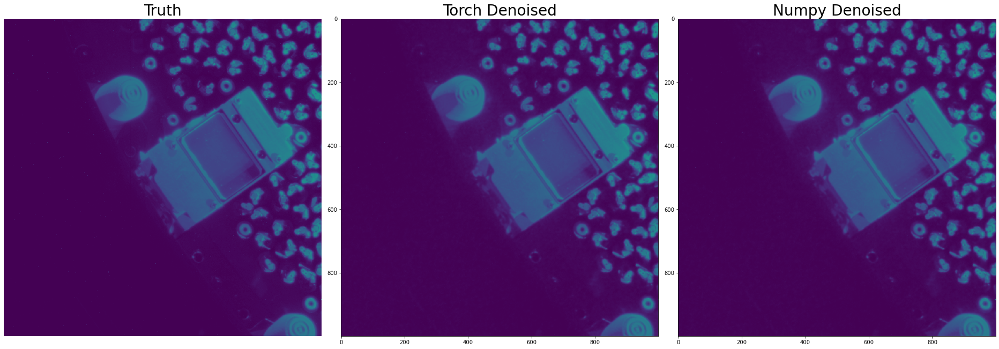

In [32]:
focalplane_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=0,
                      y_start=4000,
                      size=1000)

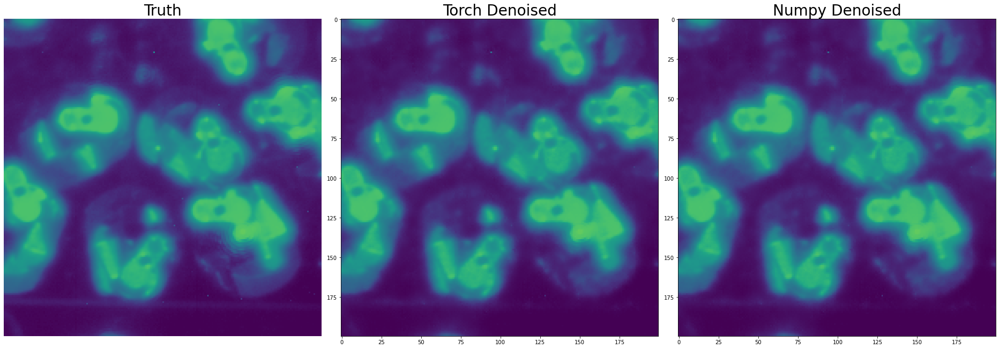

In [33]:
focalplane_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=3200,
                      y_start=2800,
                      size=200)

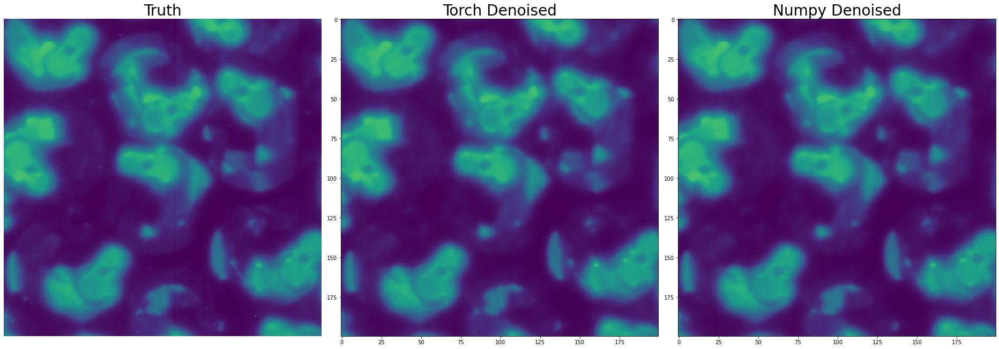

In [34]:
focalplane_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy,
                      x_start=3500,
                      y_start=2000,
                      size=200)

# Comparison of the full FVC images between `torch_full_pass` and `np_full_pass` denoising quality. Also create residvmax_residtweeen the 3 denoised images

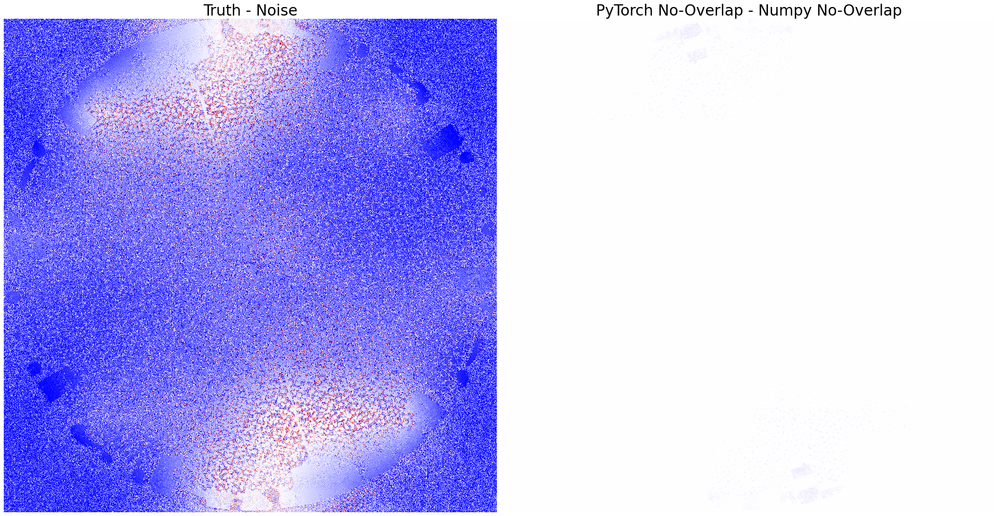

In [25]:
def focalplane_comparison(raw_data, torch_full, np_full):
    """
    Creates 3x3 grid of 3 different pairings between the 3 different
    denoising approaches. (ie. full image passes with no overlapping
    regions implemented in PyTorch and NumPy, as well as, PyTorch
    implementation of the afterburner function, which has multiple 
    overlapping regions to account for artifacts that could crop up
    when tiling inference patches).
    
    These pairs are:
        1. PyTorch full pass vs. Numpy full pass
        2. PyTorch Afterburner vs. Numpy full pass
        3. PyTorch Afterburner vs. PyTorch full pass
    """
    
    torch_np = torch_full - np_full


    fig, ax = plt.subplots(1, 2, figsize=(26, 22))
    
    # For non-residual FVC images
    vmin, vmax = np.percentile(raw_data[0][0][0], (1,99))
    # For residuals
    vmax_resid = np.percentile(np.abs((raw_data[1][0][0] - raw_data[0][0][0])), (85))
    vmin_resid = -vmax_resid

    # Comparing pytorch denoised vs. numpy denoised
    ax[0].imshow(raw_data[1][0][0] - raw_data[0][0][0], cmap='bwr', vmin=vmin_resid, vmax=vmax_resid, origin='upper', interpolation='none')
    ax[0].axis('off')
    ax[0].set_title('Truth - Noise',fontsize=28) 
    ax[1].imshow(torch_np[0][0], vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[1].axis('off')
    ax[1].set_title('PyTorch No-Overlap - Numpy No-Overlap', fontsize=28)
    
    fig.tight_layout()
    
focalplane_comparison(raw_data=test_data,
                      torch_full=saved_torch,
                      np_full=saved_numpy)

# Comparison of `np_full_pass` denoising quality over full FVC image & 200x200 patches

In [ ]:
def np_full_pass_comparison(raw_data,
                    inf_data,
                    size,
                    x_start_idx,
                    y_start_idx):
    
    data_6k_raw = raw_data[0][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    data_6k_truth = raw_data[1][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]

    full_img_inf = inf_data[0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
        
    
    fig, ax = plt.subplots(3, 3,figsize=(26, 22))
    
   
    # For full image
    vmin_full, vmax_full = np.percentile(raw_data[0][0][0], (1,99))
    # For residuals
    vmax_resid = np.percentile(np.abs((raw_data[1][0][0] - raw_data[0][0][0])), (90))
    vmin_resid = -vmax_resid
    
    # Comparing noise vs. truth
    ax[0,0].imshow(data_6k_truth, vmin=vmin_full, vmax=vmax_full, origin='upper', interpolation='none')
    ax[0,0].axis('off')
    ax[0,0].set_title('Truth',fontsize=28) 
    ax[0,1].imshow(data_6k_raw, vmin=vmin_full, vmax=vmax_full, origin='upper', interpolation='none')
    ax[0,1].axis('off')
    ax[0,1].set_title('Noise',fontsize=28) 
    ax[0,2].imshow(data_6k_truth - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[0,2].axis('off')
    ax[0,2].set_title('Truth-Noise Residual', fontsize=28)
  
    
    # Comparing Noise vs. Denoised
    ax[1,0].imshow(full_img_inf, vmin=vmin_full, vmax=vmax_full, origin='upper', interpolation='none')
    ax[1,0].axis('off')
    ax[1,0].set_title('Numpy Denoised',fontsize=28)
    ax[1,1].imshow(data_6k_raw, vmin=vmin_full, vmax=vmax_full, origin='upper', interpolation='none')
    ax[1,1].axis('off')
    ax[1,1].set_title('Noise',fontsize=28) 
    ax[1,2].imshow(full_img_inf - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[1,2].axis('off')
    ax[1,2].set_title('Numpy Denoised-Noise Residual', fontsize=28)
  
       
       
    # Comparing Denoised vs. Truth
    ax[2,0].imshow(data_6k_truth, vmin=vmin_full, vmax=vmax_full, origin='upper', interpolation='none')
    ax[2,0].axis('off')
    ax[2,0].set_title('Truth',fontsize=28) 
    ax[2,1].imshow(full_img_inf, vmin=vmin_full, vmax=vmax_full, origin='upper', interpolation='none')
    ax[2,1].axis('off')
    ax[2,1].set_title('Numpy Denoised',fontsize=28) 
    ax[2,2].imshow(data_6k_truth - full_img_inf, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    # ax[2,2].axis('off')
    ax[2,2].set_title('Truth-Numpy Denoised Residual', fontsize=28)
   
    

    fig.tight_layout()

np_full_pass_comparison(raw_data=test_data,
                inf_data=saved_numpy,
                size=6000,
                x_start_idx=0,
                y_start_idx=0)

In [ ]:
np_full_pass_comparison(raw_data=test_data,
                inf_data=saved_numpy,
                size=200,
                x_start_idx=4000,
                y_start_idx=2000)

# Comparison of `torch_full_pass` denoising quality over full FVC image & 200x200 patches

In [ ]:
def torch_full_pass_comparison(raw_data,
                    inf_data,
                    size,
                    x_start_idx,
                    y_start_idx):
    
    data_6k_raw = raw_data[0][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    data_6k_truth = raw_data[1][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]

    full_img_inf = inf_data[0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
        
    
    fig, ax = plt.subplots(3, 3,figsize=(26, 22))
    
    # For 200x200 patches
    # vmin, vmax = np.percentile(data_6k_raw, (1,99))
    # For full image
    vmin, vmax = np.percentile(raw_data[0][0][0], (1,99))
    # For residuals
    vmax_resid = np.percentile(np.abs((raw_data[1][0][0] - raw_data[0][0][0])), (90))
    vmin_resid = -vmax_resid

    # Comparing noise vs. truth
    ax[0,0].imshow(data_6k_truth, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,0].axis('off')
    ax[0,0].set_title('Truth',fontsize=28) 
    ax[0,1].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,1].axis('off')
    ax[0,1].set_title('Noise',fontsize=28) 
    ax[0,2].imshow(data_6k_truth - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[0,2].axis('off')
    ax[0,2].set_title('Truth-Noise Residual', fontsize=28)
  
    
    # Comparing Noise vs. Denoised
    ax[1,0].imshow(full_img_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,0].axis('off')
    ax[1,0].set_title('Torch',fontsize=28)
    ax[1,1].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,1].axis('off')
    ax[1,1].set_title('Noise',fontsize=28) 
    ax[1,2].imshow(full_img_inf - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[1,2].axis('off')
    ax[1,2].set_title('Torch - Noise Residual', fontsize=28)
  
       
       
    # Comparing Denoised vs. Truth
    ax[2,0].imshow(data_6k_truth, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[2,0].axis('off')
    ax[2,0].set_title('Truth',fontsize=28) 
    ax[2,1].imshow(full_img_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[2,1].axis('off')
    ax[2,1].set_title('Torch',fontsize=28) 
    ax[2,2].imshow(data_6k_truth - full_img_inf, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[2,2].axis('off')
    ax[2,2].set_title('Truth - Torch Residual', fontsize=28)
   
    

    fig.tight_layout()

torch_full_pass_comparison(raw_data=test_data,
                inf_data=saved_torch,
                size=6000,
                x_start_idx=0,
                y_start_idx=0)

In [ ]:
torch_full_pass_comparison(raw_data=test_data,
                inf_data=saved_torch,
                size=200,
                x_start_idx=4900,
                y_start_idx=3600)

# Comparison of algorithms vs noise on full FVC images & 200x200 patches

In [ ]:
def algo_noise_comparison(raw_data,
                    np_data,
                    torch_data,
                    size,
                    x_start_idx,
                    y_start_idx):
    
    # Getting 200x200 patches of the noisy/clean pairs
    data_6k_raw = raw_data[0][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    data_6k_truth = raw_data[1][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]

    # Getting the same 200x200 patches of the noisy/clean pairs within the
    # 3 different denoised images we get from pytorc_full_pass, np_full_pass
    # and pytorch_afterburneer.
    np_inf = np_data[0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    torch_inf = torch_data[0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    
    fig, ax = plt.subplots(3, 3,figsize=(26, 22))
    
    # For 200x200 patches
    # vmin, vmax = np.percentile(data_6k_raw, (1,99))
    # For full image
    vmin, vmax = np.percentile(raw_data[0][0][0], (1,99))
    # For residuals
    vmax_resid = np.percentile(np.abs((raw_data[1][0][0] - raw_data[0][0][0])), (90))
    vmin_resid = -vmax_resid
    
    # Comparing truth vs. noise 
    ax[0,0].imshow(data_6k_truth, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,0].axis('off')
    ax[0,0].set_title('Truth',fontsize=28) 
    ax[0,1].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    # ax[0,1].axis('off')
    ax[0,1].set_title('Noise',fontsize=28) 
    ax[0,2].imshow(data_6k_truth - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    # ax[0,2].axis('off')
    ax[0,2].set_title('Truth - Noise Residual', fontsize=28)
     
       
    # Comparing Torch Full Pass (ie. no overlapping patches) Denoised vs Noise
    ax[1,0].imshow(torch_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,0].axis('off')
    ax[1,0].set_title('Torch No-Overlap ',fontsize=28) 
    ax[1,1].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    # ax[1,1].axis('off')
    ax[1,1].set_title('Noise',fontsize=28) 
    ax[1,2].imshow(torch_inf - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    # ax[2,2].axis('off')
    ax[1,2].set_title('Torch No-Overlap - Noise Residual', fontsize=28)
    
    # Comparing Numpy Full Pass (ie. no overlapping patches) Denoised vs Noise
    ax[2,0].imshow(np_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[2,0].axis('off')
    ax[2,0].set_title('Numpy No-Overlap',fontsize=28) 
    ax[2,1].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    # ax[2,1].axis('off')
    ax[2,1].set_title('Noise',fontsize=28) 
    ax[2,2].imshow(np_inf - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    # ax[3,2].axis('off')
    ax[2,2].set_title('Numpy No-Overlap - Noise Residual', fontsize=28)
   
    

    fig.tight_layout()

algo_noise_comparison(raw_data=test_data,
                np_data=saved_numpy,
                torch_data=saved_torch,
                size=6000,
                x_start_idx=0,
                y_start_idx=0)

In [ ]:
algo_noise_comparison(raw_data=test_data,
                np_data=saved_numpy,
                torch_data=saved_torch,
                size=200,
                x_start_idx=3900,
                y_start_idx=3900)

In [ ]:
algo_noise_comparison(raw_data=test_data,
                np_data=saved_numpy,
                torch_data=saved_torch,
                size=200,
                x_start_idx=1900,
                y_start_idx=3900)

In [ ]:
algo_noise_comparison(raw_data=test_data,
                np_data=saved_numpy,
                torch_data=saved_torch,
                size=200,
                x_start_idx=3900,
                y_start_idx=5500)

# Comparison of algorithms vs truth on full FVC images & 200x200 patches

In [ ]:
def algo_clean_comparison(raw_data,
                    np_data,
                    torch_data,
                    size,
                    x_start_idx,
                    y_start_idx):
        
    
    # Getting 200x200 patches of the noisy/clean pairs
    data_6k_raw = raw_data[0][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    data_6k_truth = raw_data[1][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]

    # Getting the same 200x200 patches of the noisy/clean pairs within the
    # 3 different denoised images we get from pytorc_full_pass, np_full_pass
    # and pytorch_afterburneer.
    np_inf = np_data[0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    torch_inf = torch_data[0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]

    # Getting residuals of truth vs. algorithim
    truth_torch = data_6k_truth - torch_inf
    truth_np = data_6k_truth - np_inf
    
    
    fig, ax = plt.subplots(3, 3,figsize=(26, 22))
    
    # For 200x200 patches
    # vmin, vmax = np.percentile(data_6k_truth, (1,99))
    # For full image
    vmin, vmax = np.percentile(raw_data[1][0][0], (1,99))
   # Residuals
    vmax_resid = np.percentile(np.abs((raw_data[1][0][0] - raw_data[0][0][0])), (90))
    vmin_resid = -vmax_resid

    # Comparing truth vs. noise 
    ax[0,0].imshow(data_6k_truth, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,0].axis('off')
    ax[0,0].set_title('Truth',fontsize=28) 
    ax[0,1].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,1].axis('off')
    ax[0,1].set_title('Noise',fontsize=28) 
    ax[0,2].imshow(data_6k_truth - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[0,2].axis('off')
    ax[0,2].set_title('Truth - Noise Residual', fontsize=28)       
       
    # Comparing Torch Full Pass (ie. no overlapping patches) Denoised vs Noise
    ax[1,0].imshow(data_6k_truth, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,0].axis('off')
    ax[1,0].set_title('Truth',fontsize=28) 
    ax[1,1].imshow(torch_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,1].axis('off')
    ax[1,1].set_title('Torch No-Overlap',fontsize=28) 
    ax[1,2].imshow(data_6k_truth - torch_inf, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    ax[1,2].axis('off')
    ax[1,2].set_title('Truth - Torch No-Overlap Residual', fontsize=28)
    
    # Comparing Numpy Full Pass (ie. no overlapping patches) Denoised vs Noise
    ax[2,0].imshow(data_6k_truth, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[2,0].axis('off')
    ax[2,0].set_title('Truth',fontsize=28) 
    ax[2,1].imshow(np_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[2,1].axis('off')
    ax[2,1].set_title('Numpy No-Overlap',fontsize=28) 
    ax[2,2].imshow(data_6k_truth - np_inf, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    # ax[2,2].axis('off')
    ax[2,2].set_title('Truth - Numpy No-Overlap Residual', fontsize=28)
   
    

    fig.tight_layout()

algo_clean_comparison(raw_data=test_data,
                np_data=saved_numpy,
                torch_data=saved_torch,
                size=6000,
                x_start_idx=0,
                y_start_idx=0)

In [ ]:
algo_clean_comparison(raw_data=test_data,
                np_data=saved_numpy,
                torch_data=saved_torch,
                size=200,
                x_start_idx=4900,
                y_start_idx=3600)

# Plots for David showing the weird discontinuity in all the algorithms

In [ ]:
def algo_noise_comparison_vert(raw_data,
                    np_data,
                    torch_data,
                    size,
                    x_start_idx,
                    y_start_idx):
    
    # Getting 200x200 patches of the noisy/clean pairs
    data_6k_raw = raw_data[0][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    data_6k_truth = raw_data[1][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]

    # Getting the same 200x200 patches of the noisy/clean pairs within the
    # 3 different denoised images we get from pytorc_full_pass, np_full_pass
    # and pytorch_afterburneer.
    np_inf = np_data[0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    torch_inf = torch_data[0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]

    
    fig, ax = plt.subplots(3, 3,figsize=(26, 22))
    
    # For 200x200 patches
    # vmin, vmax = np.percentile(data_6k_raw, (1,99))
    # For full image
    vmin, vmax = np.percentile(raw_data[0][0][0], (1,99))
    # For residuals
    vmax_resid = np.percentile(np.abs((raw_data[1][0][0] - raw_data[0][0][0])), (90))
    vmin_resid = -vmax_resid
    
    # Visualizing the discontinuity in the denoised images
    rect1 = Rectangle((3800, 4500), 400, 1500, linewidth=4, edgecolor='r', facecolor='none')
    rect2 = Rectangle((3800, 4500), 400, 1500, linewidth=4, edgecolor='r', facecolor='none')
    rect3 = Rectangle((3800, 4500), 400, 1500, linewidth=4, edgecolor='r', facecolor='none')

    # Comparing truth vs. noise 
    ax[0,0].imshow(data_6k_truth, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,0].axis('off')
    ax[0,0].set_title('Truth',fontsize=28) 
    ax[1,0].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,0].axis('off')
    ax[1,0].set_title('Noise',fontsize=28) 
    ax[2,0].imshow(data_6k_truth - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    # ax[2,0].axis('off')
    ax[2,0].set_title('Truth - Noise Residual', fontsize=26)
       
    # Comparing Torch Full Pass (ie. no overlapping patches) Denoised vs Noise
    ax[0,1].imshow(torch_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,1].axis('off')
    ax[0,1].set_title('Torch No-Overlap ',fontsize=26) 
    ax[1,1].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,1].axis('off')
    ax[1,1].set_title('Noise',fontsize=26) 
    ax[2,1].imshow(torch_inf - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    # ax[2,2].axis('off')
    ax[2,1].add_patch(rect2)
    ax[2,1].set_title('Torch No-Overlap - Noise Residual', fontsize=26)
    
    # Comparing Numpy Full Pass (ie. no overlapping patches) Denoised vs Noise
    ax[0,2].imshow(np_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,2].axis('off')
    ax[0,2].set_title('Numpy No-Overlap',fontsize=26) 
    ax[1,2].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,2].axis('off')
    ax[1,2].set_title('Noise',fontsize=26) 
    ax[2,2].imshow(np_inf - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    # ax[2,3].axis('off')
    ax[2,2].add_patch(rect3)
    ax[2,2].set_title('Numpy No-Overlap - Noise Residual', fontsize=26)
   
    

    fig.tight_layout()

algo_noise_comparison_vert(raw_data=test_data,
                np_data=saved_numpy,
                torch_data=saved_torch,
                size=6000,
                x_start_idx=0,
                y_start_idx=0)

In [ ]:
algo_noise_comparison_vert(raw_data=test_data,
                np_data=saved_numpy,
                torch_data=saved_torch,
                size=200,
                x_start_idx=3900,
                y_start_idx=5500)

In [ ]:
def algo_noise_comparison_vert(raw_data,
                    np_data,
                    torch_data,
                    torch_afterburner_data,
                    size,
                    x_start_idx,
                    y_start_idx):
    
    # Getting 200x200 patches of the noisy/clean pairs
    data_6k_raw = raw_data[0][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    data_6k_truth = raw_data[1][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]

    # Getting the same 200x200 patches of the noisy/clean pairs within the
    # 3 different denoised images we get from pytorc_full_pass, np_full_pass
    # and pytorch_afterburneer.
    np_inf = np_data[0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    torch_inf = torch_data[0][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
    afterburner_inf = torch_afterburner_data[0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]

    
    fig, ax = plt.subplots(3, 4,figsize=(26, 22))
    
    # For 200x200 patches
    vmin, vmax = np.percentile(data_6k_raw, (1,99))
    # For full image
    vmin_full, vmax_full = np.percentile(raw_data[0][0][0], (1,99))
    # For residuals
    vmax_resid = np.percentile(np.abs((raw_data[1][0][0] - raw_data[0][0][0])), (90))
    vmin_resid = -vmax_resid
    
    # Visualizing the discontinuity in the denoised images
    rect1 = Rectangle((3800, 4500), 400, 1500, linewidth=4, edgecolor='r', facecolor='none')
    rect2 = Rectangle((3800, 4500), 400, 1500, linewidth=4, edgecolor='r', facecolor='none')
    rect3 = Rectangle((3800, 4500), 400, 1500, linewidth=4, edgecolor='r', facecolor='none')

    # Comparing truth vs. noise 
    ax[0,0].imshow(data_6k_truth, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,0].axis('off')
    ax[0,0].set_title('Truth',fontsize=28) 
    ax[1,0].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,0].axis('off')
    ax[1,0].set_title('Noise',fontsize=28) 
    ax[2,0].imshow(data_6k_truth - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    # ax[2,0].axis('off')
    ax[2,0].set_title('Truth - Noise Residual', fontsize=26)
  
    
    # Comparing Torch Afterburner Denoised vs. Noise
    ax[0,1].imshow(afterburner_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,1].axis('off')
    ax[0,1].set_title('Torch Burner',fontsize=26)
    ax[1,1].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,1].axis('off')
    ax[1,1].set_title('Noise',fontsize=26) 
    ax[2,1].imshow(afterburner_inf - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    # ax[2,1].axis('off')
    ax[2,1].add_patch(rect1)
    ax[2,1].set_title('Torch Burner - Noise Residual', fontsize=26)
  
       
       
    # Comparing Torch Full Pass (ie. no overlapping patches) Denoised vs Noise
    ax[0,2].imshow(torch_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,2].axis('off')
    ax[0,2].set_title('Torch No-Overlap ',fontsize=26) 
    ax[1,2].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,2].axis('off')
    ax[1,2].set_title('Noise',fontsize=26) 
    ax[2,2].imshow(torch_inf - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    # ax[2,2].axis('off')
    ax[2,2].add_patch(rect2)
    ax[2,2].set_title('Torch No-Overlap - Noise Residual', fontsize=26)
    
    # Comparing Numpy Full Pass (ie. no overlapping patches) Denoised vs Noise
    ax[0,3].imshow(np_inf, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[0,3].axis('off')
    ax[0,3].set_title('Numpy No-Overlap',fontsize=26) 
    ax[1,3].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
    ax[1,3].axis('off')
    ax[1,3].set_title('Noise',fontsize=26) 
    ax[2,3].imshow(np_inf - data_6k_raw, vmin=vmin_resid, vmax=vmax_resid, cmap='bwr', origin='upper', interpolation='none')
    # ax[2,3].axis('off')
    ax[2,3].add_patch(rect3)
    ax[2,3].set_title('Numpy No-Overlap - Noise Residual', fontsize=26)
   
    

    fig.tight_layout()

# algo_noise_comparison_vert(raw_data=test_data,
#                 torch_afterburner_data=torch_afterburner,
#                 np_data=np_denoised_2k,
#                 torch_data=torch_denoised_2k,
#                 size=6000,
#                 x_start_idx=0,
#                 y_start_idx=0)

In [ ]:
# def afterburner_comparison(raw_data,
#                     inf_data,
#                     size,
#                     x_start_idx,
#                     y_start_idx):
    
#     data_6k_raw = raw_data[0][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
#     data_6k_truth = raw_data[1][0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]

#     full_img_inf = inf_data[0][0][y_start_idx:y_start_idx+size, x_start_idx:x_start_idx+size]
        
    
#     fig, ax = plt.subplots(2, 2,figsize=(26, 22))
    
#     # For 200x200 patches
#     vmin, vmax = np.percentile(data_6k_raw, (1,99))
#     # For full image
#     vmin_full, vmax_full = np.percentile(raw_data[0][0][0], (1,99))

#     # Visualizing the discontinuity in the denoised images
#     rect1 = Rectangle((x_start_idx, y_start_idx), size, size, linewidth=4, edgecolor='r', facecolor='none')
#     rect2 = Rectangle((x_start_idx, y_start_idx), size, size, linewidth=4, edgecolor='r', facecolor='none')
#     rect3 = Rectangle((x_start_idx, y_start_idx), size, size, linewidth=4, edgecolor='r', facecolor='none')

#     # Full FVC img
#     ax[0,0].imshow(raw_data[0][0][0], vmin=vmin_full, vmax=vmax_full, origin='upper', interpolation='none')
#     ax[0,0].add_patch(rect1)
#     ax[0,0].axis('off')
#     ax[0,0].set_title('Noisy',fontsize=28) 
#     ax[0,1].imshow(raw_data[1][0][0], vmin=vmin_full, vmax=vmax_full, origin='upper', interpolation='none')
#     ax[0,1].add_patch(rect2)
#     ax[0,1].axis('off')
#     ax[0,1].set_title('Truth',fontsize=28) 
   

#     # 200x200 Patch FVC img
#     ax[1,0].imshow(data_6k_raw, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
#     # ax[0,0].add_patch(rect1)
#     ax[1,0].axis('off')
#     ax[1,0].set_title('Noisy',fontsize=28) 
#     ax[1,1].imshow(data_6k_truth, vmin=vmin, vmax=vmax, origin='upper', interpolation='none')
#     # ax[0,1].add_patch(rect2)
#     ax[1,1].axis('off')
#     ax[1,1].set_title('Truth',fontsize=28) 
    

#     fig.tight_layout()

# afterburner_comparison(raw_data=test_data,
#                 inf_data=torch_afterburner,
#                 size=200,
#                 x_start_idx=200,
#                 y_start_idx=3450)